# Aquifer Storage and Recovery with MODFLOW6
David Haasnoot, Justin van Beek

In [5]:
# import the necessary packages
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (5, 3) # set default figure size
import flopy as fp  # import flopy and call it fp
import glob
import imageio
import IPython

## Description of the flow problem
Consider radial flow in a confined aquifer. The aquifer extends in the $r$ direction from $r=0$ to $r=R$, where $R$ is chosen far enough away not to effect the solution.  Water is injected by the well at a rate $Q$. The head is fixed at $r=R$ to $h_R$. Flow is considered to be at steady state instantaneously. 

The initial salt concentration is equal to $c_s$ everywhere. Injection of fresh water with concentration $c_f$ starts at $t=0$ and last for $t_\text{in}$ days, after which water is extracted at the same rate $Q$ for $t_\text{out}$ days.

The parameter block is similar to the parameter block for one-dimensional (linear) flow. Some values are chosen differently, such as the time of injection. The values of the hydraulic conductivity and porosity are converted so that MODFLOW can be used to simulate radial flow (see Langevin, 2008).

In [6]:
Q_d = 40_000
Q_tot = Q_d * 1.25 ## Change this later as we actually want to produce this, currentlty we still have 80% loss
d_extrating = 62
d_injecting = 365 - d_extrating ## change later for days with water excess
print(f'Need to pump {Q_tot/d_extrating:.2f}m^3/d to full fill demand') 

Need to pump 806.45m^3/d to full fill demand


In [7]:
Q_tot

50000.0

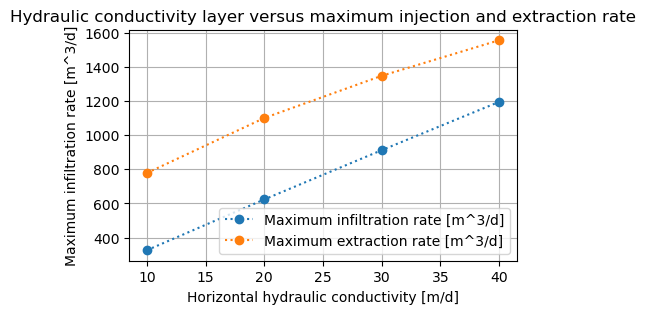

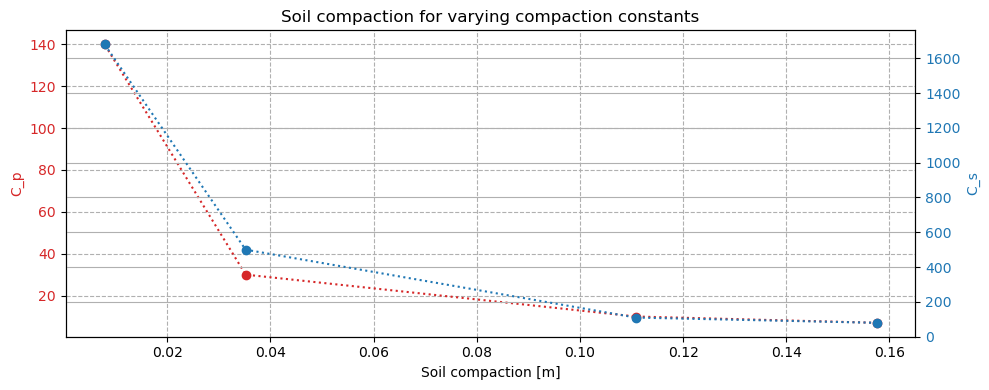

In [9]:
# Calculation maximum infiltration and extraction rate

h_d = 10                                   # Depth of the top of the aquifer beneath surface level. For configuration: 10 m clay, 20 m sand, 10 m clay.
deltah = 0.2 * h_d                         # Deltah is de maximum head in the well above surface level [m]
r_well = 0.2                               # [m] 
k_try = np.arange(10,50,10)                # Hydraulic conductivity sand layer[m/d]
c = 1000                                   # Hydraulic resistance clay layer [d]
D_aquifer = 20                             # Thickness of the aquifer [m]

Q_max_in = (2*np.pi*k_try*D_aquifer*deltah)/np.log(np.sqrt(k_try*D_aquifer*c)/r_well)
q_max_ext = np.sqrt(k_try/(60*60*24))/30                                              # Maximum allowed specific discharge on the borehole in [m/s]
Q_max_ext = q_max_ext * 2 * D_aquifer*np.pi*r_well * (60*60*24)                       # Maximum allowed extraction rate [m^3/d]


#print(f'The maximum infiltration rate is {Q_max_in:.2f} [m^3/d]')
#print(f'The maximum extractionn rate is {Q_max_ext:.2f} [m^3/d]')

plt.figure()
plt.title('Hydraulic conductivity layer versus maximum injection and extraction rate')
plt.xlabel('Horizontal hydraulic conductivity [m/d]')
plt.ylabel('Maximum infiltration rate [m^3/d]')
plt.plot(k_try,Q_max_in, linestyle=':', marker='o', label='Maximum infiltration rate [m^3/d]')
plt.plot(k_try,Q_max_ext, linestyle=':', marker='o', label ='Maximum extraction rate [m^3/d]')
plt.grid()
plt.legend()
plt.savefig(r'figures/Hydraulic conductivity layer versus maximum injection and extraction rate.png',bbox_inches="tight")

# Calculation maximum soil compaction

D_c = 10                               # Thickness confining layer [m]
C_p = [7,10,30,140]                    # Primary compaction constant [-]
C_s = [80,110,500,1680]                # Secular compaction constant [-]
t_extr = 62                            # Extraction time [days]
phi =h_d *10                           # Pore pressure [kN/m^2]
d_phi = deltah * 10                    # Change of pore pressure [kN/m^2]
Z=np.zeros(4)

for i in range (len(C_p)):
                Z[i] = D_c * (1/C_p[i] + np.log10(t_extr)/C_s[i])*np.log((phi+0.5*d_phi)/phi) 
                
                
#Z = D_c * (1/C_p + np.log10(t_extr)/C_s)*np.log((phi+0.5*d_phi)/phi)

fig, ax1 = plt.subplots(figsize=(10,4))
plt.title('Soil compaction for varying compaction constants')
plt.grid(linestyle='--')
color = 'tab:red'
ax1.set_xlabel('Soil compaction [m]')
ax1.set_ylabel('C_p', color=color)
ax1.plot(Z, C_p, linestyle=':', marker='o', color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

plt.grid()
color = 'tab:blue'
ax2.set_ylabel('C_s', color=color)  # we already handled the x-label with ax1
ax2.plot(Z, C_s, linestyle=':', marker='o', color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()  # otherwise the right y-label is slightly clipped
fig.savefig(r'figures/Soil compaction for varying compaction constants.png',bbox_inches="tight")
plt.show()


#print(f'Koppejan drawdown is {Z:.2f} [m]')


In [4]:
# domain size and boundary conditions
R = 200 # length of domain, m
hR = 0 # head at r=R

# aquifer parameters
k = 30 # hydraulic conductivity, m/d -> between 10 - 40: start with 30
H = 20 # aquifer thickness, m
npor = 0.35 # porosity, generally 0.25- 0.5 

# flow

Q = Q_tot/d_extrating # extraction rate, m^3/d 
Q_in = Q_tot / (d_injecting)# injection rate m^3/d

# transport
alphaL = 0.5 # longitudinal dispersivity in horizontal direction, m - ###################### something to check!! -> slides guest lecture
alphaT = alphaL / 10 # transverse dispersivity in horizontal direction, m
diffusion_coef = 0 # diffusion coeffcient

# concentration
cs = 30 # initial concentration, kg/m^3 (=g/L)
cf = 0 # concentration injected water, kg/m^3 (=g/L)

# space discretization
delr = 0.2 # length of cell along row (in x-direction), m
delc = 1 # width of cells normal to plane of flow (in y-direction), m
z = [0, -H] # top and bottom(s) of layers
nlay = 1 # number of layers
nrow = 1 # number of rows
ncol = round(R / delr) # number of columns
rw = 0.2 # radius of well, m
r = rw + np.cumsum(delr * np.ones(ncol)) - 0.5 * delr # radial coordinates of centers of cells, m

# convert parameters for radial flow following procedure of Langevin, 2008
theta = 2 * np.pi # angle for full circle
krad = k * r * theta # convert k for radial flow
nporrad = npor * r * theta # convert porosity for radial flow

# time discretization
########## injection
tin = d_injecting # injection time, d - rest of the year - maybe change later
delt = 0.1 # time step, d
nstepin = round(tin / delt) # computed number of steps during injection, integer

######### extraction
tout = d_extrating # extraction time, d
delt = 0.1 # time step, d
nstepout = round(tout / delt) # computed number of steps during extraction, integer

# model name and workspace
modelname = 'modelrad' # name of model
gwfname = modelname + 'f' # name of flow model
gwtname = modelname + 't' # name of transport model
modelws = './' + modelname # model workspace to be used

## Create Simulation

In [5]:
# simulation
sim = fp.mf6.MFSimulation(sim_name=modelname, # name of simulation
                          version='mf6', # version of MODFLOW
                          exe_name='../bin/mf6', # absolute path to MODFLOW executable
                          sim_ws=modelws, # path to workspace where all files are stored
                         )

# time discretization
tdis = fp.mf6.ModflowTdis(simulation=sim, # add to the simulation called sim (defined above)
                          time_units="DAYS", 
                          nper=2, # number of stress periods 
                          perioddata=[[tin, nstepin, 1],
                                      [tout, nstepout, 1]], # period length, number of steps, timestep multiplier
                         )

## Create groundwater flow model (`gwf`)
<!-- Changes in the groundwater flow model:
* Use the converted value of $k$ in the npf package and use the logarithmic averaging option to compute cell-by-cell hydraulic conductivities.
* Use the discharge $Q$ in the well package. -->

In [6]:
# groundwater flow model
gwf = fp.mf6.ModflowGwf(simulation=sim, # add to simulation called sim
                        modelname=gwfname, # name of gwf model
                        save_flows=True, # make sure all flows are stored in binary output file
                       )

# iterative model solver
gwf_ims  = fp.mf6.ModflowIms(simulation=sim, # add to simulation called sim
                             filename=gwf.name + '.ims', # file name to store ims
                             linear_acceleration="BICGSTAB", # use BIConjuGantGradientSTABalized method
                            )                                                                                                
# register solver
sim.register_ims_package(solution_file=gwf_ims, # name of iterative model solver instance
                         model_list=[gwf.name], # list with name of groundwater flow model
                        )   

# discretization
gwf_dis = fp.mf6.ModflowGwfdis(model=gwf, # add to groundwater flow model called gwf
                               nlay=nlay, 
                               nrow=nrow, 
                               ncol=ncol, 
                               delr=delr, 
                               delc=delc, 
                               top=z[0], 
                               botm=z[1:], 
                              )

# aquifer properties
gwf_npf  = fp.mf6.ModflowGwfnpf(model=gwf, 
                                k=krad, # horizontal k value
                                alternative_cell_averaging="LOGARITHMIC", # logarithmic averaging
                                save_flows=True, # save the flow for all cells
                               )
    
# initial condition
gwf_ic = fp.mf6.ModflowGwfic(model=gwf, 
                             strt=hR, # initial head used for iterative solution
                            )

# wells  ############## change when we inject
wellin = [[(0, 0, 0),  Q_in, cf]]   # [(layer, row, col), U, concentration]
wellout = [[(0, 0, 0),  -Q, cf]] # specified concentration is not used, but must be specified 
wel_spd = {0: wellin, 1: wellout} # stress period data for periods 0 and 1
gwf_wel = fp.mf6.ModflowGwfwel(model=gwf, 
                               stress_period_data=wel_spd, 
                               auxiliary=['CONCENTRATION'],
                               pname='WEL1', # package name
                              )

# constant head 
chd0 = [[(0,  0,  ncol-1), hR, cs]] # [(layer, row, col), head, concentration]
chd_spd  = {0: chd0}    # Stress period data
gwf_chd = fp.mf6.ModflowGwfchd(model=gwf, 
                               stress_period_data=chd_spd, 
                               auxiliary=['CONCENTRATION'],
                               pname='CHD1', # package name
                              )
    
# output control
oc = fp.mf6.ModflowGwfoc(model=gwf, 
                         saverecord=[("HEAD", "ALL"), ("BUDGET", "ALL")], # what to save
                         budget_filerecord=f"{gwfname}.cbc", # file name where all budget output is stored
                         head_filerecord=f"{gwfname}.hds", # file name where all head output is stored
                        )

## Create groundwater transport model (`gwt`)
<!-- Changes in the transport model: Use the converted value of the porosity in the mst package. -->

In [7]:
# groundwater transport model
gwt = fp.mf6.ModflowGwt(simulation=sim, 
                        modelname=gwtname, # name of groundwater transport model
                       )

# iterative model solver
gwt_ims  = fp.mf6.ModflowIms(simulation=sim,
                             filename=gwt.name + '.ims', # must be different than file name of gwf model ims
                             linear_acceleration="BICGSTAB",
                            ) 
sim.register_ims_package(solution_file=gwt_ims, 
                         model_list=[gwt.name],
                        )

# discretization
gwt_dis = fp.mf6.ModflowGwtdis(model=gwt, 
                               nlay=nlay, 
                               nrow=nrow, 
                               ncol=ncol, 
                               delr=delr, 
                               delc=delc, 
                               top=z[0], 
                               botm=z[1:], 
                              )

# mobile storage and transfer
gwt_sto = fp.mf6.ModflowGwtmst(model=gwt, 
                               porosity=nporrad, # porosity
                               save_flows=True,
                              )

# initial condition
gwt_ic = fp.mf6.ModflowGwtic(model=gwt, 
                             strt=cs, # initial concentration
                            ) 

# source sink mixing
sourcelist = [("WEL1", "AUX", "CONCENTRATION"), ("CHD1", "AUX", "CONCENTRATION")]
ssm = fp.mf6.ModflowGwtssm(model=gwt, 
                           sources=sourcelist, 
                           save_flows=True,
                           pname='SSM1', 
                          )

# advection
adv = fp.mf6.ModflowGwtadv(model=gwt,  
                           scheme="TVD",  # use Total Variation Diminishing (TVD)
                           pname='ADV1',
                          )

# dispersion
dsp = fp.mf6.ModflowGwtdsp(model=gwt, 
                           alh=alphaL,
                           ath1=alphaT, 
                           diffc=diffusion_coef,
                           pname='DSP1', 
                          )

# output control
oc = fp.mf6.ModflowGwtoc(model=gwt,
                         saverecord=[("CONCENTRATION", "ALL"), ("BUDGET", "ALL")], # what to save
                         budget_filerecord=f"{gwtname}.cbc", # file name where all budget output is stored
                         concentration_filerecord=f"{gwtname}.ucn", # file name where all concentration output is stored
                        )

In [8]:
fp.mf6.ModflowGwfgwt(simulation=sim, 
                     exgtype="GWF6-GWT6", 
                     exgmnamea=gwf.name , 
                     exgmnameb=gwt.name , 
                     filename=f"{modelname}.gwfgwt",
                    );

## Write input files and solve model

In [9]:
sim.write_simulation(silent=True)
success, _ = sim.run_simulation(silent=True) 
if success == 1:
    print('Model solved successfully')
else:
    print('Solve failed')

Model solved successfully


## Read and plot heads and compare to exact solution
The exact solution is
\begin{equation}
h = -\frac{Q}{2\pi kH}\ln(r/R)
\end{equation}

In [10]:
hds = gwf.output.head() # get handle to binary head file
head = hds.get_alldata().squeeze() # get the head data from the file

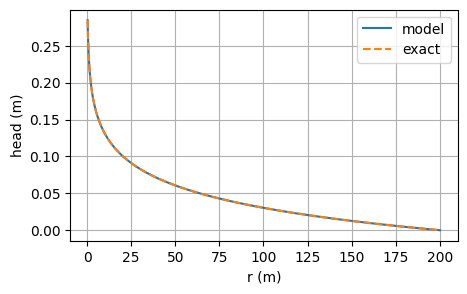

In [11]:
plt.plot(r, head[0], label='model')
hexact = -Q_in / (2 * np.pi * k * H) * np.log(r / r[-1])
plt.plot(r, hexact, '--', label='exact')
plt.xlabel("r (m)")
plt.ylabel("head (m)")
plt.legend()
plt.grid()

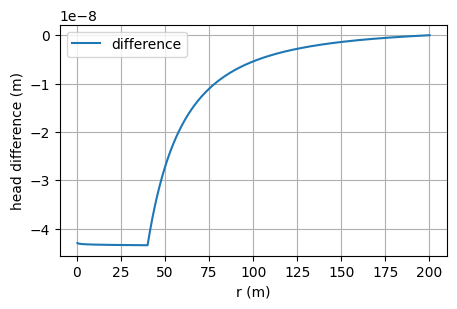

In [12]:
plt.plot(r, head[0] - hexact,label="difference")
plt.xlabel("r (m)")
plt.ylabel("head difference (m)")
plt.legend()
plt.grid();

## Read concentration data

<!-- Plot the concentration vs. $r$ at 10 day intervals. Make separate plots for the injection and extraction periods. -->

In [13]:
cobj = gwt.output.concentration() # get handle to binary concentration file
c = cobj.get_alldata().squeeze() # get the concentration data from the file
times = np.array(cobj.get_times()) # get the times and convert to array

In [14]:
t_end_index = len(times)
t_begin_index = int(0.9*len(times))

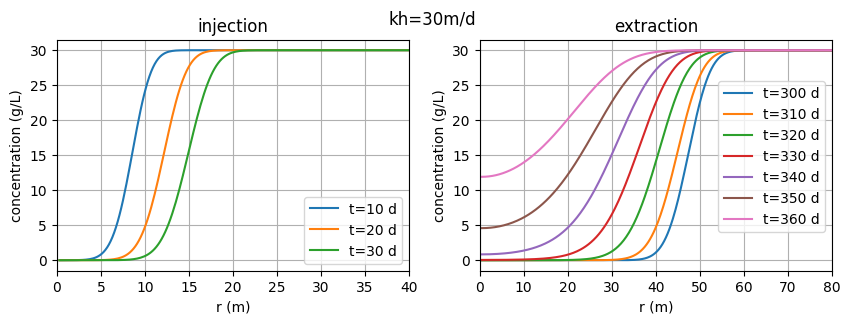

In [15]:
# plot concentration vs. x for three different times   
fname = r"figures/concentration_over_time_kh30.png"
plt.figure(figsize=(10, 3))
plt.suptitle(f"kh={k}m/d")
plt.subplot(121)
for t in np.arange(10, 31, 10):
    itime = np.abs(times - t).argmin() # find index of value in times closest to t
    plt.plot(r, c[itime,:], label=f't={times[itime]:.0f} d')
plt.title('injection')
plt.xlabel('r (m)')
plt.ylabel('concentration (g/L)')
plt.xlim(0, 40)
plt.legend()
plt.grid()

plt.subplot(122)
for t in np.arange(300, 365, 10):
    itime = np.abs(times - t).argmin() # find index of value in times closest to t
    plt.plot(r, c[itime,:], label=f't={times[itime]:.0f} d')
plt.title('extraction')
plt.xlabel('r (m)')
plt.ylabel('concentration (g/L)')
plt.xlim(0, 80)
plt.legend(bbox_to_anchor=(1,0.85))
plt.grid()

plt.savefig(fname,bbox_inches="tight")

## Recovery efficiency
The recovery efficiency is computed using $c_\text{limit}=1$ kg/m$^3$ (g/L) as follows

In [16]:
climit = 1 # limit concentration, g/L

In [17]:
for itime in range(t_begin_index, t_end_index):
    if c[itime, 0] > climit:
        break
print(f'first time when c exceeds climit: {round(times[itime], 2)} d when concentration is {c[itime, 0]:.2f} g/L')

if t_end_index == times[itime]:
    print(f'recovery efficiency = 100%')
else:
    rec_eff = ((times[itime - 1] - tin) * Q) / (tin * Q_in) #Q  needed as injection and extraction rates are not the same
    print(f'recovery efficiency = {rec_eff * 100:.1f} %')

first time when c exceeds climit: 340.9 d when concentration is 1.02 g/L
recovery efficiency = 61.0 %


## Mass balance

In [18]:
gwt_ic = fp.mf6.ModflowGwtic(model=gwt, 
                             strt=cs, # initial concentration
                            ) 

sim.write_simulation(silent=True)
success, _ = sim.run_simulation(silent=True) 
if success == 1:
    print('Model solved successfully')
else:
    print('Solve failed')

cobj = gwt.output.concentration() # get handle to binary concentration file
c = cobj.get_alldata().squeeze() # get the concentration data from the file
times = np.array(cobj.get_times()) # get the times and convert to array

Model solved successfully


\begin{equation}
\Delta M_1 = (Q c_f - Q c_s)\Delta t
\end{equation}
During an extraction time sep, the mass increase is
\begin{equation}
\Delta M_1 = (-Q c_0 + Q c_s)\Delta t
\end{equation}
If the mass balance is met, this change in mass must be equal to the change in mass in the system $\Delta M_2$
\begin{equation}
\Delta M_2 = \sum_i{\left[(c_i(t)-c_i(t-\Delta t)) (r_{i+1}^2 - r_{i}^2) \pi H n\right]}
\end{equation}
where $r_i$ is the radial distance of the left side of cell $i$ -> not the centre!

The mass balance is computed for one time step as follows 

### Simulate one cycle.
<!-- Plot the change in mass during the entire cycle vs. the time step. Plot both $\Delta M1$ and $\Delta M2$ in one graph. Don't forget to add a legend. -->

In [19]:
#### This still needs to change as something doesn't match: propably an assumption somewhere that Q is constant in or out but its not
delM1 = np.zeros(len(times))
delM2 = np.zeros(len(times))
itime_out = np.abs(times - tin).argmin()
for index, t in enumerate(times):
    itime = np.abs(times - t).argmin() # find index of value in times closest to t
    # skip first timestep as itime-1 doesn't exisit
    if itime == 0:
        delM1[itime] = np.nan
        delM2[itime] = np.nan
    else:
        # change based on in flow or outflow 
        if itime < itime_out:
            # injecting
            delM1[index] = (+Q_in * cf -  Q_in * cs) * delt  # now different Q_in than Q_out
        else:
            # extracting
            delM1[index] = (- Q * c[itime, 0] + Q * c[itime, -1]) * delt
        delM2_i = 0
        for index_r, r_i in enumerate(r):
            # changes in all cells
            radius_centre = r_i
            radius_left = radius_centre - 0.5 * delr
            radius_right = radius_centre + 0.5 * delr
            delM2_i += (c[itime,index_r] - c[itime - 1,index_r]) * (radius_right**2 - radius_left**2) * H * np.pi * npor
        delM2[index] = delM2_i

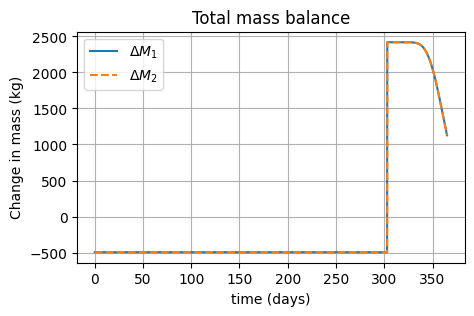

In [20]:
plt.plot(times, delM1, label=r'$\Delta M_1$')
plt.plot(times, delM2, label=r'$\Delta M_2$',ls="--")
plt.legend()
plt.title('Total mass balance')
plt.xlabel('time (days)')
plt.ylabel('Change in mass (kg)');
plt.grid()

### Compute the recovery efficiency for many  cycles

In [21]:
from flopy.mf6.mfbase import VerbosityLevel
sim.simulation_data.verbosity_level = VerbosityLevel.quiet

In [22]:
run = True # takes long
if run: 
    time_break_lst = []
    rec_eff_lst = []
    cycle_n = np.arange(0, 10,1)
    c_arr = np.zeros((len(cycle_n)+1, ncol))
    c_store_all = np.zeros((len(cycle_n), nstepin+nstepout,ncol))
    c_arr[0] = np.array([cs] * ncol)
    c_prev = cs
    for index_cycle in cycle_n:
        # initial condition from prev time period
        gwt_ic = fp.mf6.ModflowGwtic(model=gwt, 
                                     strt=c_arr[index_cycle], # initial concentration
                                     ) 
        # here also change the injection after the first two years. 
    
        
        # write model, solve model, and read concentration data
        sim.write_simulation(silent=True)
        success, _ = sim.run_simulation(silent=True) 
        if success == 1:
            print(f'Model solved successfully for {index_cycle}', end="\r")
        else:
            print('Solve failed')
            break
        
        cobj = gwt.output.concentration() # get handle to binary concentration file
        c_i = cobj.get_alldata().squeeze() # get the concentration data from the file
        for itime in range(t_begin_index, t_end_index):
            if c_i[itime, 0] > climit:
                time_break_lst.append(itime)
                break
    
        c_arr[index_cycle+1] = c_i[itime - 1]
        c_store_all[index_cycle] = c_i
        rec_eff = ((times[itime - 1] - tin) * Q) / (tin * Q_in) # Q  needed as injection and extraction rates are not the same
        rec_eff_lst.append(rec_eff*100)

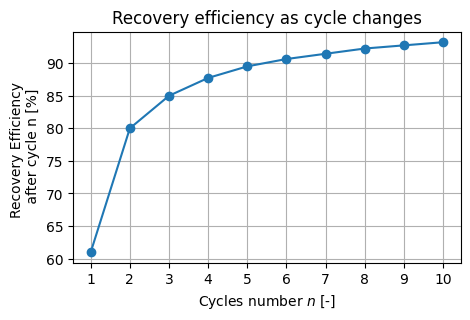

In [23]:
fname = r"figures/recovery_eff_cycles.png"
if run: 
    cycle_n_arr = np.array(cycle_n) + 1
    plt.plot(cycle_n_arr,rec_eff_lst,marker="o")
    plt.ylabel("Recovery Efficiency \n after cycle n [%]")
    plt.xlabel(r"Cycles number $n$ [-]")
    plt.title(r"Recovery efficiency as cycle changes")
    plt.xticks(ticks=cycle_n_arr)
    plt.grid()
    plt.savefig(fname)
else: 
    img = matplotlib.image.imread(fname)
    fig, ax = plt.subplots()
    ax.imshow(img)
    ax.axis("off")

actual design factors: (assumed constant at 1.25)

In [34]:
1 + (100 - np.array(rec_eff_lst))/100

array([1.39032258, 1.2       , 1.15      , 1.12258065, 1.10483871,
       1.09354839, 1.08548387, 1.07741935, 1.07258065, 1.06774194])

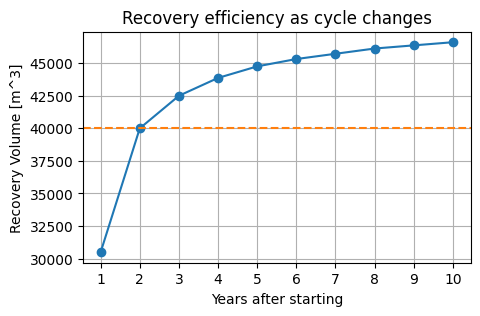

In [24]:
fname = r"figures/recovery_Q_cycles.png"
if run: 
    cycle_n_arr = np.array(cycle_n) + 1
    rec_eff_arr = np.array(rec_eff_lst)
    plt.plot(cycle_n_arr,rec_eff_arr*Q_tot/100,marker="o")
    plt.axhline(Q_d,ls="--",color="C1",label="Design production volume")
    plt.ylabel("Recovery Volume [m^3]")
    plt.xlabel(r"Years after starting")
    plt.title(r"Recovery efficiency as cycle changes")
    plt.xticks(ticks=cycle_n_arr)
    plt.grid()
    plt.savefig(fname)
else: 
    img = matplotlib.image.imread(fname)
    fig, ax = plt.subplots()
    ax.imshow(img)
    ax.axis("off")

### Make GIFS

In [25]:
import matplotlib
cmap1 = matplotlib.cm.tab10
cmap2 = matplotlib.cm.tab20

In [26]:
# i = 5
# plt.plot(0,0,marker="*",color=cmap1((i)/10))
# plt.plot(0,1,marker="*",color=cmap2((i/10)+0.05))

In [27]:
run = False # takes long
keep_prev_years = True

if keep_prev_years: fname = r'figures/overview_years.gif'
else: fname = r'figures/overview_per_year.gif'

if run: 
    if keep_prev_years: plt.figure(figsize=(12, 3))
    for i in cycle_n:
        c_i = c_store_all[i]
        if not keep_prev_years: plt.figure(figsize=(12, 3))
        # plot concentration vs. x for three different times   
        for t in np.arange(10, 365, 10):
            itime = np.abs(times - t).argmin() # find index of value in times closest to t
            if itime < itime_out:
                plt.title(f'Year {i+1}, t={t}d (injection)')
                color = cmap2((i/10)+0.05)
                alpha = 0.5
            else:
                plt.title(f'Year {i+1}, t={t}d (extraction)')
                color = cmap1((i)/10)
                alpha = 0.99
    
            plt.plot(r, c_i[itime,:], color=color,alpha=alpha) #, label=f't={times[itime]:.0f} d')
            plt.xlabel('r (m)')
            plt.ylabel('concentration (g/L)')
            plt.xlim(0, 80)
            # plt.legend(loc='lower right')
            # plt.grid()
            if t < 100: t_name = f'0{t}'
            else: t_name = f'{t}'
            if i < 9: i_name = f'0{i+1}'
            else: i_name = f'{i+1}'
            plt.savefig(rf"figures/overview_year_{i_name}_{t_name}.png")
        if not keep_prev_years: plt.close()
    if keep_prev_years: plt.close()
    
    
    figs =  glob.glob("figures/overview_year_*.png")
    speed = 20
    with imageio.get_writer(fname, mode='I',duration=5) as writer:
        for fig in figs:
            image = imageio.v3.imread(fig)
            for i in range(speed):
                writer.append_data(image)

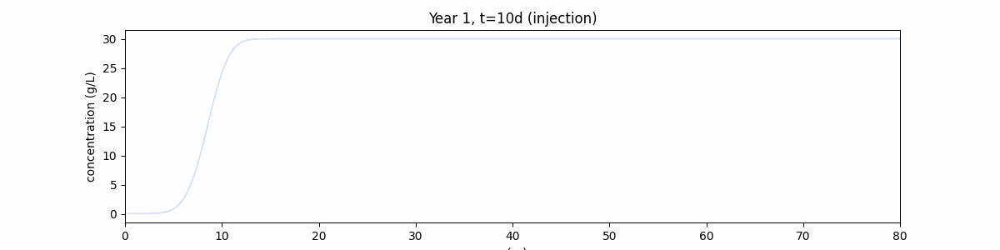

In [28]:
IPython.display.Image(filename=fname)